In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.figure_factory as ff
import seaborn as sns 
import matplotlib.pyplot as plt
from datasist.structdata import detect_outliers 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier,AdaBoostClassifier, BaggingClassifier,VotingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
import xgboost as xgb
from imblearn.over_sampling import SMOTE
from sklearn.metrics import accuracy_score, f1_score,accuracy_score,recall_score,precision_score
import pickle
sns.set(rc={"figure.figsize": [9,9]}, font_scale=1.5)

In [2]:
df=pd.read_csv(r"C:\Users\omara\OneDrive\Desktop\DATA_SCIENCE_COURSE\final project\hotel reservation data set .csv")

In [3]:
df.head()

,Booking_ID,number of adults,number of children,number of weekend nights,number of week nights,type of meal,car parking space,room type,lead time,market segment type,repeated,P-C,P-not-C,average price,special requests,date of reservation,booking status
0,INN00001,1,1,2,5,Meal Plan 1,0,Room_Type 1,224,Offline,0,0,0,88.00,0,10/2/2015,Not_Canceled
1,INN00002,1,0,1,3,Not Selected,0,Room_Type 1,5,Online,0,0,0,106.68,1,11/6/2018,Not_Canceled
2,INN00003,2,1,1,3,Meal Plan 1,0,Room_Type 1,1,Online,0,0,0,50.00,0,2/28/2018,Canceled
3,INN00004,1,0,0,2,Meal Plan 1,0,Room_Type 1,211,Online,0,0,0,100.00,1,5/20/2017,Canceled
4,INN00005,1,0,1,2,Not Selected,0,Room_Type 1,48,Online,0,0,0,77.00,0,4/11/2018,Canceled


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36285 entries, 0 to 36284
Data columns (total 17 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Booking_ID                36285 non-null  object 
 1   number of adults          36285 non-null  int64  
 2   number of children        36285 non-null  int64  
 3   number of weekend nights  36285 non-null  int64  
 4   number of week nights     36285 non-null  int64  
 5   type of meal              36285 non-null  object 
 6   car parking space         36285 non-null  int64  
 7   room type                 36285 non-null  object 
 8   lead time                 36285 non-null  int64  
 9   market segment type       36285 non-null  object 
 10  repeated                  36285 non-null  int64  
 11  P-C                       36285 non-null  int64  
 12  P-not-C                   36285 non-null  int64  
 13  average price             36285 non-null  float64
 14  specia

In [5]:
df.describe()

,number of adults,number of children,number of weekend nights,number of week nights,car parking space,lead time,repeated,P-C,P-not-C,average price,special requests
count,36285.000000,36285.000000,36285.000000,36285.000000,36285.000000,36285.000000,36285.000000,36285.000000,36285.000000,36285.000000,36285.000000
mean,1.844839,0.105360,0.810693,2.204602,0.030977,85.239851,0.025630,0.023343,0.153369,103.421636,0.619733
std,0.518813,0.402704,0.870590,1.410946,0.173258,85.938796,0.158032,0.368281,1.753931,35.086469,0.786262
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.000000,0.000000,0.000000,1.000000,0.000000,17.000000,0.000000,0.000000,0.000000,80.300000,0.000000
50%,2.000000,0.000000,1.000000,2.000000,0.000000,57.000000,0.000000,0.000000,0.000000,99.450000,0.000000
75%,2.000000,0.000000,2.000000,3.000000,0.000000,126.000000,0.000000,0.000000,0.000000,120.000000,1.000000
max,4.000000,10.000000,7.000000,17.000000,1.000000,443.000000,1.000000,13.000000,58.000000,540.000000,5.000000


In [6]:
# What is the distribution of booking status (Canceled vs. Not_Canceled)

In [7]:
px.pie(df,names="booking status",color_discrete_sequence=["mediumseagreen","red"],title="Canceled Vs Not Canceled reservations ").update_traces(textinfo ="value")

In [8]:
# What is the distribution of number of adults 

In [9]:
px.pie(df,names=df["number of adults"],title="Number of adults reservation ").update_traces(textinfo ="value")

In [10]:
 # What is the distribution of number of children 

In [11]:
px.pie(df,names=df["number of children"],title="Number of children reservation ").update_traces(textinfo ="value")

In [12]:
df.sample(3)

,Booking_ID,number of adults,number of children,number of weekend nights,number of week nights,type of meal,car parking space,room type,lead time,market segment type,repeated,P-C,P-not-C,average price,special requests,date of reservation,booking status
12260,INN12261,2,0,1,3,Meal Plan 1,0,Room_Type 1,17,Offline,0,0,0,85.00,0,10/10/2018,Not_Canceled
26467,INN26468,1,0,0,2,Meal Plan 1,0,Room_Type 1,6,Corporate,0,0,0,65.00,0,9/30/2017,Not_Canceled
7154,INN07155,3,0,2,5,Meal Plan 1,0,Room_Type 4,73,Offline,0,0,0,117.64,1,7/1/2018,Not_Canceled


In [13]:
# number of weekend nights reservation vs number of week reservation 

In [14]:
px.scatter(df,x=df["number of week nights"],y=df["number of weekend nights"])

In [15]:
# which type of meal is the highest booking with the booking status 

In [16]:
px.histogram(df,x=df["type of meal"],color= df["booking status"],color_discrete_sequence=["mediumseagreen","red"],title="Meal type distribtion with booking status ")

In [17]:
# car parking space distribution with booking status 

In [18]:
px.histogram(df,x=df["car parking space"],color= df["booking status"],color_discrete_sequence=["mediumseagreen","red"],title="Car parking space distribution")

In [19]:
#room types distribution with booking status 

In [20]:
px.histogram(df,x=df["room type"],color= df["booking status"],color_discrete_sequence=["mediumseagreen","red"],title="room type distribtion with booking status ")

In [21]:
# lead time distribution with booking status 

In [22]:
px.histogram(df,x=df["lead time"],color= df["booking status"],color_discrete_sequence=["mediumseagreen","red"],title="lead time  distribtion with booking status ")

In [23]:
# Does the presence of children affect adult reservation behavior?

In [24]:
df[(df["number of children"] > 0) & (df["number of adults"] > 0)][["number of adults", "booking status"]].value_counts().sort_index()

number of adults  booking status
1                 Canceled            47
                  Not_Canceled       100
2                 Canceled           907
                  Not_Canceled      1483
3                 Canceled             6
                  Not_Canceled        20
Name: count, dtype: int64

In [25]:
df_with_chlidren=df[(df["number of children"] > 0) & (df["number of adults"] > 0)]

In [26]:
df_with_chlidren

,Booking_ID,number of adults,number of children,number of weekend nights,number of week nights,type of meal,car parking space,room type,lead time,market segment type,repeated,P-C,P-not-C,average price,special requests,date of reservation,booking status
0,INN00001,1,1,2,5,Meal Plan 1,0,Room_Type 1,224,Offline,0,0,0,88.00,0,10/2/2015,Not_Canceled
2,INN00003,2,1,1,3,Meal Plan 1,0,Room_Type 1,1,Online,0,0,0,50.00,0,2/28/2018,Canceled
6,INN00007,1,1,1,4,Meal Plan 1,0,Room_Type 1,34,Online,0,0,0,107.55,1,10/15/2017,Not_Canceled
8,INN00009,1,1,0,4,Meal Plan 1,0,Room_Type 1,121,Offline,0,0,0,96.90,1,7/6/2018,Not_Canceled
60,INN00061,2,2,0,1,Meal Plan 1,1,Room_Type 6,2,Online,0,0,0,258.00,1,9/2/2018,Not_Canceled
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36221,INN36222,2,2,2,4,Meal Plan 1,0,Room_Type 6,62,Online,0,0,0,207.90,1,9/24/2018,Not_Canceled
36227,INN36228,2,2,0,1,Meal Plan 1,0,Room_Type 6,20,Online,0,0,0,231.00,1,8/6/2018,Not_Canceled
36231,INN36232,2,1,0,2,Meal Plan 1,0,Room_Type 1,1,Online,0,0,0,167.00,1,6/28/2018,Not_Canceled
36249,INN36250,2,2,0,3,Meal Plan 1,0,Room_Type 6,65,Online,0,0,0,177.30,0,7/27/2018,Canceled


In [27]:
px.histogram(df_with_chlidren,x="number of adults",color="booking status",color_discrete_sequence=["mediumseagreen","red"],title="Adults with children by Booking Status ")

In [28]:
df[df["number of children"]==0][["number of adults","booking status"]].value_counts().sort_index()

number of adults  booking status
1                 Canceled           1812
                  Not_Canceled       5743
2                 Canceled           8213
                  Not_Canceled      15507
3                 Canceled            857
                  Not_Canceled       1435
4                 Canceled              3
                  Not_Canceled         13
Name: count, dtype: int64

In [29]:
df_zero_chlidren=df[df["number of children"]==0]

In [30]:
df_zero_chlidren

,Booking_ID,number of adults,number of children,number of weekend nights,number of week nights,type of meal,car parking space,room type,lead time,market segment type,repeated,P-C,P-not-C,average price,special requests,date of reservation,booking status
1,INN00002,1,0,1,3,Not Selected,0,Room_Type 1,5,Online,0,0,0,106.68,1,11/6/2018,Not_Canceled
3,INN00004,1,0,0,2,Meal Plan 1,0,Room_Type 1,211,Online,0,0,0,100.00,1,5/20/2017,Canceled
4,INN00005,1,0,1,2,Not Selected,0,Room_Type 1,48,Online,0,0,0,77.00,0,4/11/2018,Canceled
5,INN00006,1,0,0,2,Meal Plan 2,0,Room_Type 1,346,Offline,0,0,0,100.00,1,9/13/2016,Canceled
7,INN00008,3,0,1,3,Meal Plan 1,0,Room_Type 4,83,Online,0,0,0,105.61,1,12/26/2018,Not_Canceled
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36280,INN36282,2,0,0,2,Meal Plan 2,0,Room_Type 1,346,Online,0,0,0,115.00,1,9/13/2018,Canceled
36281,INN36283,2,0,1,3,Meal Plan 1,0,Room_Type 1,34,Online,0,0,0,107.55,1,10/15/2017,Not_Canceled
36282,INN36284,2,0,1,3,Meal Plan 1,0,Room_Type 4,83,Online,0,0,0,105.61,1,12/26/2018,Not_Canceled
36283,INN36285,3,0,0,4,Meal Plan 1,0,Room_Type 1,121,Offline,0,0,0,96.90,1,7/6/2018,Not_Canceled


In [31]:
px.histogram(df_zero_chlidren,x="number of adults",color="booking status",color_discrete_sequence=["mediumseagreen","red"],title="Adults without children by Booking Status")


In [32]:
df.head()

,Booking_ID,number of adults,number of children,number of weekend nights,number of week nights,type of meal,car parking space,room type,lead time,market segment type,repeated,P-C,P-not-C,average price,special requests,date of reservation,booking status
0,INN00001,1,1,2,5,Meal Plan 1,0,Room_Type 1,224,Offline,0,0,0,88.00,0,10/2/2015,Not_Canceled
1,INN00002,1,0,1,3,Not Selected,0,Room_Type 1,5,Online,0,0,0,106.68,1,11/6/2018,Not_Canceled
2,INN00003,2,1,1,3,Meal Plan 1,0,Room_Type 1,1,Online,0,0,0,50.00,0,2/28/2018,Canceled
3,INN00004,1,0,0,2,Meal Plan 1,0,Room_Type 1,211,Online,0,0,0,100.00,1,5/20/2017,Canceled
4,INN00005,1,0,1,2,Not Selected,0,Room_Type 1,48,Online,0,0,0,77.00,0,4/11/2018,Canceled


In [33]:
# Does the absence of adults in bookings with children affect the likelihood of cancellation?

In [34]:
df_zero_adults=df[df["number of adults"]==0]

In [35]:
px.histogram(df_zero_adults,x="number of children",color="booking status",color_discrete_sequence=["mediumseagreen","red"],title="Children Without Adults By Booking Status")

In [36]:
# Does the total number of people in a reservation affect the likelihood of cancellation? 

In [37]:
df["number of children and adults"]=df["number of adults"]+df["number of children"]

In [38]:
df.head()

,Booking_ID,number of adults,number of children,number of weekend nights,number of week nights,type of meal,car parking space,room type,lead time,market segment type,repeated,P-C,P-not-C,average price,special requests,date of reservation,booking status,number of children and adults
0,INN00001,1,1,2,5,Meal Plan 1,0,Room_Type 1,224,Offline,0,0,0,88.00,0,10/2/2015,Not_Canceled,2
1,INN00002,1,0,1,3,Not Selected,0,Room_Type 1,5,Online,0,0,0,106.68,1,11/6/2018,Not_Canceled,1
2,INN00003,2,1,1,3,Meal Plan 1,0,Room_Type 1,1,Online,0,0,0,50.00,0,2/28/2018,Canceled,3
3,INN00004,1,0,0,2,Meal Plan 1,0,Room_Type 1,211,Online,0,0,0,100.00,1,5/20/2017,Canceled,1
4,INN00005,1,0,1,2,Not Selected,0,Room_Type 1,48,Online,0,0,0,77.00,0,4/11/2018,Canceled,1


In [39]:
df.groupby("number of children and adults")["booking status"].value_counts().sort_index()

number of children and adults  booking status
1                              Canceled           1812
                               Not_Canceled       5744
2                              Canceled           8280
                               Not_Canceled      15666
3                              Canceled           1393
                               Not_Canceled       2460
4                              Canceled            398
                               Not_Canceled        514
5                              Canceled              5
                               Not_Canceled         10
10                             Not_Canceled          1
11                             Canceled              1
12                             Not_Canceled          1
Name: count, dtype: int64

In [40]:
px.histogram(df,x="number of children and adults",color="booking status",color_discrete_sequence=["mediumseagreen","red"],title="Total People by Booking Status")

In [41]:
# Question 5  Does the total number of nights (week + weekend) affect the likelihood of cancellation?

In [42]:
df["number of total nights"]=df["number of week nights"]+df["number of weekend nights"] 

In [43]:
px.histogram(df,x=df["number of total nights"],color="booking status",color_discrete_sequence=["mediumseagreen","red"],title="Total number of nights by Booking Status ")

In [44]:
df.head()

,Booking_ID,number of adults,number of children,number of weekend nights,number of week nights,type of meal,car parking space,room type,lead time,market segment type,repeated,P-C,P-not-C,average price,special requests,date of reservation,booking status,number of children and adults,number of total nights
0,INN00001,1,1,2,5,Meal Plan 1,0,Room_Type 1,224,Offline,0,0,0,88.00,0,10/2/2015,Not_Canceled,2,7
1,INN00002,1,0,1,3,Not Selected,0,Room_Type 1,5,Online,0,0,0,106.68,1,11/6/2018,Not_Canceled,1,4
2,INN00003,2,1,1,3,Meal Plan 1,0,Room_Type 1,1,Online,0,0,0,50.00,0,2/28/2018,Canceled,3,4
3,INN00004,1,0,0,2,Meal Plan 1,0,Room_Type 1,211,Online,0,0,0,100.00,1,5/20/2017,Canceled,1,2
4,INN00005,1,0,1,2,Not Selected,0,Room_Type 1,48,Online,0,0,0,77.00,0,4/11/2018,Canceled,1,3


In [45]:
# Does the number of people in a booking affect the type of room selected?

In [46]:
px.strip(df,x="number of children and adults",y="room type",color="room type",title="Room Type by Total People ")

In [47]:
px.strip(df,x=df["number of total nights"],y="room type",color="room type",title="Room Type by Total People ")

In [48]:
# How do the total number of people, room type, and number of nights affect the average price?

In [49]:
df_renamed = df.rename(columns={
    "number of children and adults": "total people",
    "number of total nights": "nights"
})

In [50]:
px.scatter_matrix( df_renamed,dimensions=["total people", "nights", "average price "],color="room type",title="Scatter Matrix: Total People, Nights, and Average Price")

In [51]:
# heat map for all numeric categories 

<Axes: >

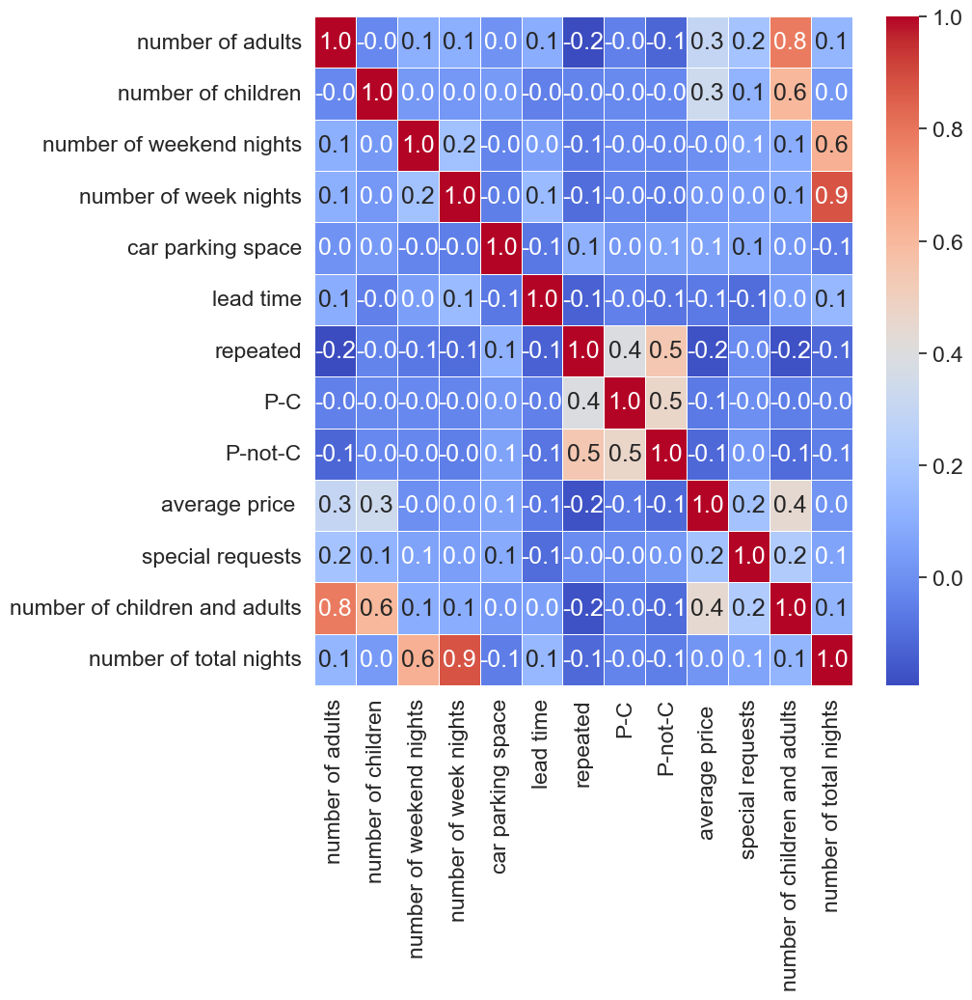

In [52]:
sns.heatmap(df.corr(numeric_only=True), annot=True, cmap='coolwarm', fmt='.1f', linewidths=0.5)

In [53]:
# How does the 'type of meal' affect the average price?


In [54]:
px.strip(df,x="type of meal",y="average price ",color="type of meal")

In [55]:
# Question 9 Does lead time affect the likelihood of cancellation?

In [56]:
px.box(df,x="booking status",y="lead time",title="Lead Time by Booking Status",color="booking status",color_discrete_sequence=["mediumseagreen","red"])

In [57]:
px.scatter(df,x="lead time",title="Lead Time by Booking Status",color="booking status",color_discrete_sequence=["mediumseagreen","red"])

In [58]:
# How does the market segment type affect the likelihood of cancellation?

In [59]:
px.histogram(df,x="market segment type",color="booking status",title="Booking Status by Market Segment Type",color_discrete_sequence=["mediumseagreen","red"])

In [60]:
df.head(5)

,Booking_ID,number of adults,number of children,number of weekend nights,number of week nights,type of meal,car parking space,room type,lead time,market segment type,repeated,P-C,P-not-C,average price,special requests,date of reservation,booking status,number of children and adults,number of total nights
0,INN00001,1,1,2,5,Meal Plan 1,0,Room_Type 1,224,Offline,0,0,0,88.00,0,10/2/2015,Not_Canceled,2,7
1,INN00002,1,0,1,3,Not Selected,0,Room_Type 1,5,Online,0,0,0,106.68,1,11/6/2018,Not_Canceled,1,4
2,INN00003,2,1,1,3,Meal Plan 1,0,Room_Type 1,1,Online,0,0,0,50.00,0,2/28/2018,Canceled,3,4
3,INN00004,1,0,0,2,Meal Plan 1,0,Room_Type 1,211,Online,0,0,0,100.00,1,5/20/2017,Canceled,1,2
4,INN00005,1,0,1,2,Not Selected,0,Room_Type 1,48,Online,0,0,0,77.00,0,4/11/2018,Canceled,1,3


In [61]:
# Which market segment type has the highest average price?

In [62]:
px.histogram(df,x="market segment type",y="average price ",color="market segment type",title= "Market Segment Type by Average price",histfunc="avg")

In [63]:
# Are repeated guests more likely to cancel their bookings?

In [64]:
px.histogram(df,x="repeated",color="booking status",color_discrete_sequence=["mediumseagreen","red"],title="Repeated Visit by Booking Status")

In [65]:
# For every complementary booking ID, how many non-canceled reservations happened until the next complementary booking?

In [66]:
complementary_df = (df[df["market segment type"] == "Complementary"].sort_values("date of reservation").reset_index(drop=True))
counts = []
for i in range(len(complementary_df) - 1):
    comp_id = complementary_df.loc[i, "Booking_ID"]
    start_date = complementary_df.loc[i, "date of reservation"]
    end_date = complementary_df.loc[i + 1, "date of reservation"]
    
    total_reservations = df[
        (df["date of reservation"] > start_date)
        & (df["date of reservation"] < end_date)
    ]["Booking_ID"].count()  
    
    counts.append({
        "Complementary Booking ID": comp_id,
        "Total Reservations Until Next": total_reservations
    })
visual_df = pd.DataFrame(counts)

px.bar(
    visual_df,
    x="Complementary Booking ID",
    y="Total Reservations Until Next",
    title="All Reservations Between Complementary Bookings",
    color="Total Reservations Until Next",
    color_continuous_scale="tempo"
)



In [67]:
# How does the number of special requests impact the booking status?

In [68]:
px.histogram(df,x="special requests",color="booking status",color_discrete_sequence=["mediumseagreen","red"],title="Special Request by Booking Stauts")

In [69]:
df.sample(5)

,Booking_ID,number of adults,number of children,number of weekend nights,number of week nights,type of meal,car parking space,room type,lead time,market segment type,repeated,P-C,P-not-C,average price,special requests,date of reservation,booking status,number of children and adults,number of total nights
17050,INN17051,2,0,0,3,Meal Plan 1,0,Room_Type 1,61,Offline,0,0,0,75.00,1,11/23/2018,Not_Canceled,2,3
15098,INN15099,2,0,2,0,Not Selected,0,Room_Type 1,51,Online,0,0,0,108.00,3,10/9/2018,Not_Canceled,2,2
6635,INN06636,2,0,1,4,Meal Plan 1,0,Room_Type 4,1,Online,0,0,0,100.47,0,12/7/2018,Not_Canceled,2,5
15766,INN15767,2,0,0,2,Meal Plan 1,0,Room_Type 4,20,Online,0,0,0,174.00,1,9/16/2018,Not_Canceled,2,2
1075,INN01076,2,0,2,3,Meal Plan 1,0,Room_Type 4,76,Online,0,0,0,110.15,1,3/20/2018,Not_Canceled,2,5


In [70]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36285 entries, 0 to 36284
Data columns (total 19 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Booking_ID                     36285 non-null  object 
 1   number of adults               36285 non-null  int64  
 2   number of children             36285 non-null  int64  
 3   number of weekend nights       36285 non-null  int64  
 4   number of week nights          36285 non-null  int64  
 5   type of meal                   36285 non-null  object 
 6   car parking space              36285 non-null  int64  
 7   room type                      36285 non-null  object 
 8   lead time                      36285 non-null  int64  
 9   market segment type            36285 non-null  object 
 10  repeated                       36285 non-null  int64  
 11  P-C                            36285 non-null  int64  
 12  P-not-C                        36285 non-null 

In [71]:
df.columns

Index(['Booking_ID', 'number of adults', 'number of children',
       'number of weekend nights', 'number of week nights', 'type of meal',
       'car parking space', 'room type', 'lead time', 'market segment type',
       'repeated', 'P-C', 'P-not-C', 'average price ', 'special requests',
       'date of reservation', 'booking status',
       'number of children and adults', 'number of total nights'],
      dtype='object')

In [72]:
df.columns=df.columns.str.strip().str.replace(" ","_").str.replace("-","_").str.lower()


In [73]:
df.columns

Index(['booking_id', 'number_of_adults', 'number_of_children',
       'number_of_weekend_nights', 'number_of_week_nights', 'type_of_meal',
       'car_parking_space', 'room_type', 'lead_time', 'market_segment_type',
       'repeated', 'p_c', 'p_not_c', 'average_price', 'special_requests',
       'date_of_reservation', 'booking_status',
       'number_of_children_and_adults', 'number_of_total_nights'],
      dtype='object')

In [74]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36285 entries, 0 to 36284
Data columns (total 19 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   booking_id                     36285 non-null  object 
 1   number_of_adults               36285 non-null  int64  
 2   number_of_children             36285 non-null  int64  
 3   number_of_weekend_nights       36285 non-null  int64  
 4   number_of_week_nights          36285 non-null  int64  
 5   type_of_meal                   36285 non-null  object 
 6   car_parking_space              36285 non-null  int64  
 7   room_type                      36285 non-null  object 
 8   lead_time                      36285 non-null  int64  
 9   market_segment_type            36285 non-null  object 
 10  repeated                       36285 non-null  int64  
 11  p_c                            36285 non-null  int64  
 12  p_not_c                        36285 non-null 

In [75]:
df=df.convert_dtypes()

In [76]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36285 entries, 0 to 36284
Data columns (total 19 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   booking_id                     36285 non-null  string 
 1   number_of_adults               36285 non-null  Int64  
 2   number_of_children             36285 non-null  Int64  
 3   number_of_weekend_nights       36285 non-null  Int64  
 4   number_of_week_nights          36285 non-null  Int64  
 5   type_of_meal                   36285 non-null  string 
 6   car_parking_space              36285 non-null  Int64  
 7   room_type                      36285 non-null  string 
 8   lead_time                      36285 non-null  Int64  
 9   market_segment_type            36285 non-null  string 
 10  repeated                       36285 non-null  Int64  
 11  p_c                            36285 non-null  Int64  
 12  p_not_c                        36285 non-null 

In [77]:
df.head(5)

,booking_id,number_of_adults,number_of_children,number_of_weekend_nights,number_of_week_nights,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,date_of_reservation,booking_status,number_of_children_and_adults,number_of_total_nights
0,INN00001,1,1,2,5,Meal Plan 1,0,Room_Type 1,224,Offline,0,0,0,88.0,0,10/2/2015,Not_Canceled,2,7
1,INN00002,1,0,1,3,Not Selected,0,Room_Type 1,5,Online,0,0,0,106.68,1,11/6/2018,Not_Canceled,1,4
2,INN00003,2,1,1,3,Meal Plan 1,0,Room_Type 1,1,Online,0,0,0,50.0,0,2/28/2018,Canceled,3,4
3,INN00004,1,0,0,2,Meal Plan 1,0,Room_Type 1,211,Online,0,0,0,100.0,1,5/20/2017,Canceled,1,2
4,INN00005,1,0,1,2,Not Selected,0,Room_Type 1,48,Online,0,0,0,77.0,0,4/11/2018,Canceled,1,3


In [78]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36285 entries, 0 to 36284
Data columns (total 19 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   booking_id                     36285 non-null  string 
 1   number_of_adults               36285 non-null  Int64  
 2   number_of_children             36285 non-null  Int64  
 3   number_of_weekend_nights       36285 non-null  Int64  
 4   number_of_week_nights          36285 non-null  Int64  
 5   type_of_meal                   36285 non-null  string 
 6   car_parking_space              36285 non-null  Int64  
 7   room_type                      36285 non-null  string 
 8   lead_time                      36285 non-null  Int64  
 9   market_segment_type            36285 non-null  string 
 10  repeated                       36285 non-null  Int64  
 11  p_c                            36285 non-null  Int64  
 12  p_not_c                        36285 non-null 

In [79]:
df["date_of_reservation"]=pd.to_datetime(df["date_of_reservation"],format='%m/%d/%Y',errors="coerce")

In [80]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36285 entries, 0 to 36284
Data columns (total 19 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   booking_id                     36285 non-null  string        
 1   number_of_adults               36285 non-null  Int64         
 2   number_of_children             36285 non-null  Int64         
 3   number_of_weekend_nights       36285 non-null  Int64         
 4   number_of_week_nights          36285 non-null  Int64         
 5   type_of_meal                   36285 non-null  string        
 6   car_parking_space              36285 non-null  Int64         
 7   room_type                      36285 non-null  string        
 8   lead_time                      36285 non-null  Int64         
 9   market_segment_type            36285 non-null  string        
 10  repeated                       36285 non-null  Int64         
 11  p_c            

In [81]:
df.isna().sum()

booking_id                        0
number_of_adults                  0
number_of_children                0
number_of_weekend_nights          0
number_of_week_nights             0
type_of_meal                      0
car_parking_space                 0
room_type                         0
lead_time                         0
market_segment_type               0
repeated                          0
p_c                               0
p_not_c                           0
average_price                     0
special_requests                  0
date_of_reservation              37
booking_status                    0
number_of_children_and_adults     0
number_of_total_nights            0
dtype: int64

In [82]:
df.dropna(axis=0,inplace=True)

In [83]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 36248 entries, 0 to 36284
Data columns (total 19 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   booking_id                     36248 non-null  string        
 1   number_of_adults               36248 non-null  Int64         
 2   number_of_children             36248 non-null  Int64         
 3   number_of_weekend_nights       36248 non-null  Int64         
 4   number_of_week_nights          36248 non-null  Int64         
 5   type_of_meal                   36248 non-null  string        
 6   car_parking_space              36248 non-null  Int64         
 7   room_type                      36248 non-null  string        
 8   lead_time                      36248 non-null  Int64         
 9   market_segment_type            36248 non-null  string        
 10  repeated                       36248 non-null  Int64         
 11  p_c                 

In [84]:
df.isna().sum()

booking_id                       0
number_of_adults                 0
number_of_children               0
number_of_weekend_nights         0
number_of_week_nights            0
type_of_meal                     0
car_parking_space                0
room_type                        0
lead_time                        0
market_segment_type              0
repeated                         0
p_c                              0
p_not_c                          0
average_price                    0
special_requests                 0
date_of_reservation              0
booking_status                   0
number_of_children_and_adults    0
number_of_total_nights           0
dtype: int64

In [85]:
df.columns

Index(['booking_id', 'number_of_adults', 'number_of_children',
       'number_of_weekend_nights', 'number_of_week_nights', 'type_of_meal',
       'car_parking_space', 'room_type', 'lead_time', 'market_segment_type',
       'repeated', 'p_c', 'p_not_c', 'average_price', 'special_requests',
       'date_of_reservation', 'booking_status',
       'number_of_children_and_adults', 'number_of_total_nights'],
      dtype='object')

In [86]:
df["day_name"]=df["date_of_reservation"].dt.day_name()
df["month"]=df["date_of_reservation"].dt.month
df["year"]=df["date_of_reservation"].dt.year


In [87]:
df.head()

,booking_id,number_of_adults,number_of_children,number_of_weekend_nights,number_of_week_nights,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,...,p_not_c,average_price,special_requests,date_of_reservation,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year
0,INN00001,1,1,2,5,Meal Plan 1,0,Room_Type 1,224,Offline,...,0,88.0,0,2015-10-02,Not_Canceled,2,7,Friday,10,2015
1,INN00002,1,0,1,3,Not Selected,0,Room_Type 1,5,Online,...,0,106.68,1,2018-11-06,Not_Canceled,1,4,Tuesday,11,2018
2,INN00003,2,1,1,3,Meal Plan 1,0,Room_Type 1,1,Online,...,0,50.0,0,2018-02-28,Canceled,3,4,Wednesday,2,2018
3,INN00004,1,0,0,2,Meal Plan 1,0,Room_Type 1,211,Online,...,0,100.0,1,2017-05-20,Canceled,1,2,Saturday,5,2017
4,INN00005,1,0,1,2,Not Selected,0,Room_Type 1,48,Online,...,0,77.0,0,2018-04-11,Canceled,1,3,Wednesday,4,2018


In [88]:
df.columns

Index(['booking_id', 'number_of_adults', 'number_of_children',
       'number_of_weekend_nights', 'number_of_week_nights', 'type_of_meal',
       'car_parking_space', 'room_type', 'lead_time', 'market_segment_type',
       'repeated', 'p_c', 'p_not_c', 'average_price', 'special_requests',
       'date_of_reservation', 'booking_status',
       'number_of_children_and_adults', 'number_of_total_nights', 'day_name',
       'month', 'year'],
      dtype='object')

In [89]:
df["type_of_meal"].unique()

<StringArray>
['Meal Plan 1', 'Not Selected', 'Meal Plan 2', 'Meal Plan 3']
Length: 4, dtype: string

In [90]:
df["room_type"].unique()

<StringArray>
['Room_Type 1', 'Room_Type 4', 'Room_Type 2', 'Room_Type 6', 'Room_Type 5',
 'Room_Type 7', 'Room_Type 3']
Length: 7, dtype: string

In [91]:
df["market_segment_type"].unique()

<StringArray>
['Offline', 'Online', 'Corporate', 'Aviation', 'Complementary']
Length: 5, dtype: string

In [92]:
df["special_requests"].unique()

<IntegerArray>
[0, 1, 3, 2, 4, 5]
Length: 6, dtype: Int64

In [93]:
df["booking_status"].unique()

<StringArray>
['Not_Canceled', 'Canceled']
Length: 2, dtype: string

In [94]:
df["number_of_children_and_adults"].unique()

<IntegerArray>
[2, 1, 3, 4, 5, 12, 10, 11]
Length: 8, dtype: Int64

In [95]:
df.columns

Index(['booking_id', 'number_of_adults', 'number_of_children',
       'number_of_weekend_nights', 'number_of_week_nights', 'type_of_meal',
       'car_parking_space', 'room_type', 'lead_time', 'market_segment_type',
       'repeated', 'p_c', 'p_not_c', 'average_price', 'special_requests',
       'date_of_reservation', 'booking_status',
       'number_of_children_and_adults', 'number_of_total_nights', 'day_name',
       'month', 'year'],
      dtype='object')

In [96]:
df.drop(["booking_id","number_of_adults","number_of_children","number_of_weekend_nights","number_of_week_nights","date_of_reservation"],axis=1,inplace=True)

In [97]:
df.columns

Index(['type_of_meal', 'car_parking_space', 'room_type', 'lead_time',
       'market_segment_type', 'repeated', 'p_c', 'p_not_c', 'average_price',
       'special_requests', 'booking_status', 'number_of_children_and_adults',
       'number_of_total_nights', 'day_name', 'month', 'year'],
      dtype='object')

<Axes: >

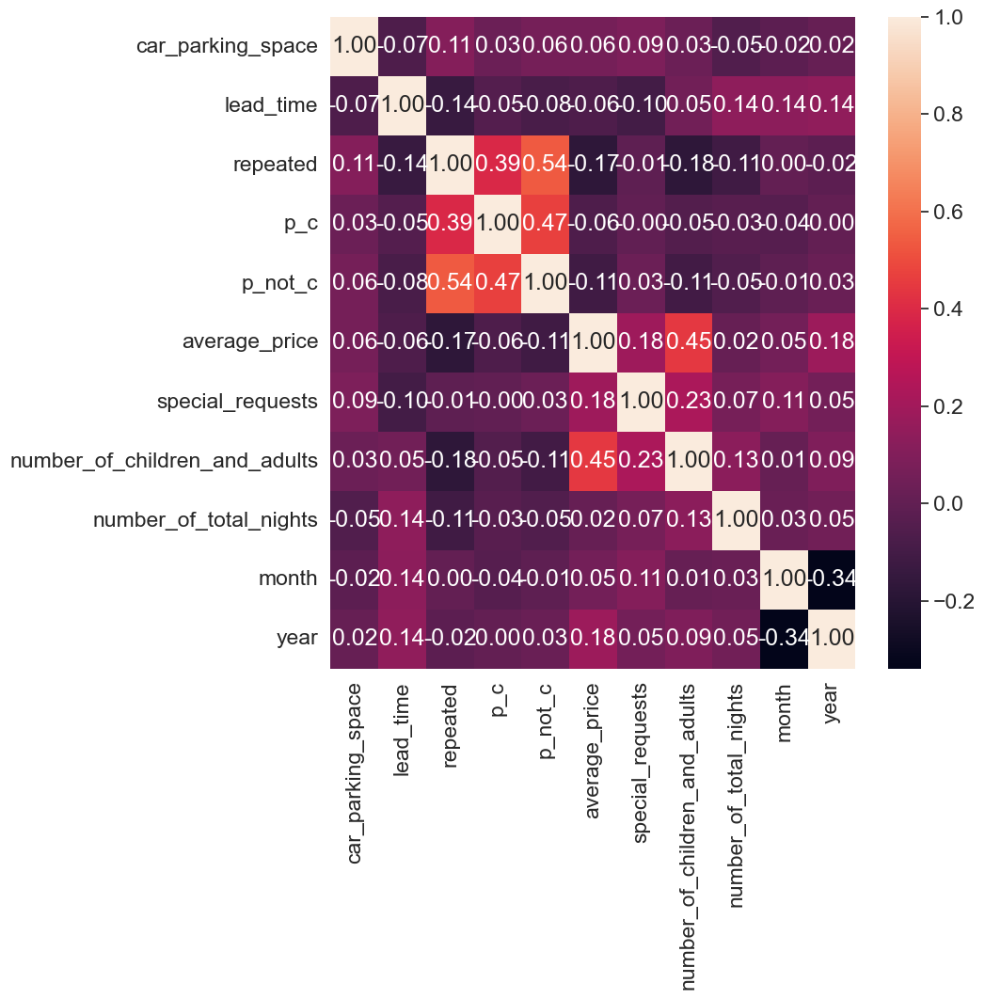

In [98]:
sns.heatmap(df.corr(numeric_only=True),annot=True,fmt=".2f")

In [99]:
df.columns

Index(['type_of_meal', 'car_parking_space', 'room_type', 'lead_time',
       'market_segment_type', 'repeated', 'p_c', 'p_not_c', 'average_price',
       'special_requests', 'booking_status', 'number_of_children_and_adults',
       'number_of_total_nights', 'day_name', 'month', 'year'],
      dtype='object')

In [100]:
px.box(df,x=df["average_price"])

In [101]:
df[df["average_price"]==df["average_price"].max()]

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year
33114,Meal Plan 1,0,Room_Type 1,35,Offline,0,0,0,540.0,0,Canceled,2,1,Sunday,3,2018


In [102]:
df[df["average_price"]>=179.5].shape[0]

1067

In [103]:
df[df["average_price"]==375.5]

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year
9461,Meal Plan 1,0,Room_Type 4,21,Online,0,0,0,375.5,0,Not_Canceled,3,2,Sunday,12,2018


In [104]:
df[df["average_price"]>=179.5].year.unique()

array([2018, 2017])

In [105]:
df.groupby("year")[["average_price"]].mean()

,average_price
year,
2015,88.0
2016,100.0
2017,90.032118
2018,106.373606


In [106]:
index=detect_outliers(df,0,["average_price"])
df.loc[index, "average_price"] = df["average_price"].median()

In [107]:
px.box(df,x=df["average_price"])

In [108]:
px.box(df,x=df["lead_time"])

In [109]:
df[df["lead_time"]>=290].shape[0]

1332

In [110]:
df[(df["lead_time"]>=290)&(df["booking_status"]=="Not_Canceled")].shape[0]

262

In [111]:
df[(df["lead_time"]>=290)&(df["booking_status"]=="Canceled")].shape[0]

1070

In [112]:
df["lead_time"].nunique()

352

In [113]:
px.histogram(df,x=df["lead_time"])

In [114]:
df.groupby(df["lead_time"])[["lead_time"]].count()

,lead_time
lead_time,
0,1295
1,1078
2,643
3,626
4,627
...,...
381,2
386,69
418,60


In [115]:
def leadtimehandling(leadtime):
    if leadtime <= 1:
        return "Same Day"
    elif leadtime <= 7:
        return "Short Notice"
    elif leadtime <=30 :
        return "Medium Term"
    elif leadtime <= 365 :
        return "Long Term"
    else:
         return "Very Long Term"

df["lead_time"]=df["lead_time"].apply(leadtimehandling)

In [116]:
df.head()

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year
0,Meal Plan 1,0,Room_Type 1,Long Term,Offline,0,0,0,88.0,0,Not_Canceled,2,7,Friday,10,2015
1,Not Selected,0,Room_Type 1,Short Notice,Online,0,0,0,106.68,1,Not_Canceled,1,4,Tuesday,11,2018
2,Meal Plan 1,0,Room_Type 1,Same Day,Online,0,0,0,50.0,0,Canceled,3,4,Wednesday,2,2018
3,Meal Plan 1,0,Room_Type 1,Long Term,Online,0,0,0,100.0,1,Canceled,1,2,Saturday,5,2017
4,Not Selected,0,Room_Type 1,Long Term,Online,0,0,0,77.0,0,Canceled,1,3,Wednesday,4,2018


In [117]:
df["lead_time"].unique()

array(['Long Term', 'Short Notice', 'Same Day', 'Medium Term',
       'Very Long Term'], dtype=object)

In [118]:
df.columns

Index(['type_of_meal', 'car_parking_space', 'room_type', 'lead_time',
       'market_segment_type', 'repeated', 'p_c', 'p_not_c', 'average_price',
       'special_requests', 'booking_status', 'number_of_children_and_adults',
       'number_of_total_nights', 'day_name', 'month', 'year'],
      dtype='object')

<Axes: >

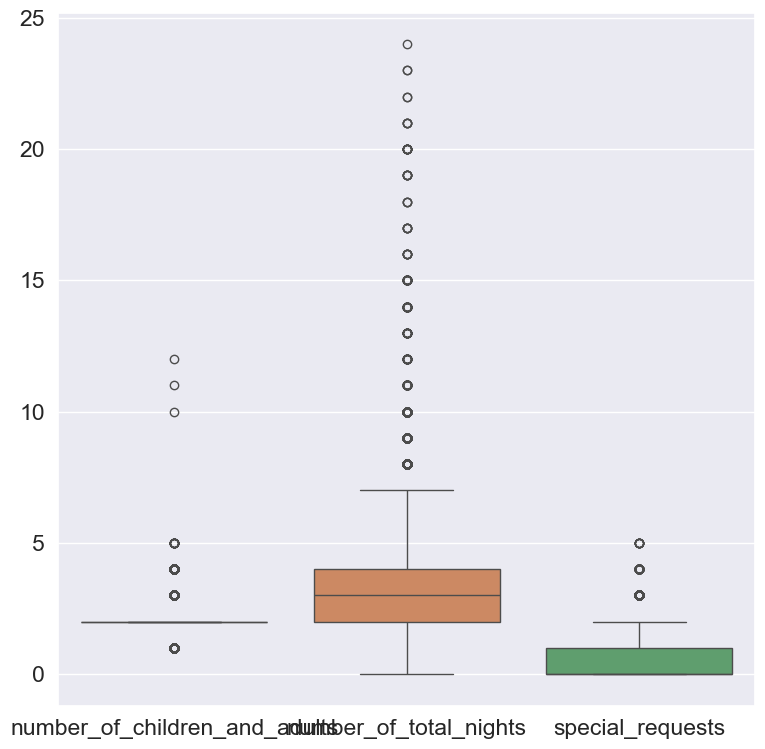

In [119]:
sns.boxplot(df[["number_of_children_and_adults","number_of_total_nights","special_requests"]])

In [120]:
px.box(df,x=df["number_of_total_nights"])

In [121]:
df[df["number_of_total_nights"]==24]

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year
19512,Meal Plan 1,0,Room_Type 1,Long Term,Online,0,0,0,90.95,1,Canceled,2,24,Wednesday,7,2018


In [122]:
sorted(df["number_of_total_nights"].unique())

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24]

In [123]:
df.groupby(df["number_of_total_nights"])["p_c"].count()

number_of_total_nights
0        78
1      6600
2      8467
3     10042
4      5887
5      2590
6      1028
7       974
8       179
9       111
10      108
11       39
12       24
13       18
14       32
15       31
16        6
17        5
18        3
19        6
20       11
21        4
22        2
23        2
24        1
Name: p_c, dtype: Int64

In [124]:
def stay_bin(x):
    if x == 0:
        return "Day Use"
    elif x <= 3:
        return "Short Stay"
    elif x <= 7:
        return "Week Stay"
    elif x <= 14:
        return "Two Weeks Stay"
    else:
        return "Long Stay"
df["number_of_total_nights"] = df["number_of_total_nights"].apply(stay_bin)


In [125]:
df.head()

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year
0,Meal Plan 1,0,Room_Type 1,Long Term,Offline,0,0,0,88.0,0,Not_Canceled,2,Week Stay,Friday,10,2015
1,Not Selected,0,Room_Type 1,Short Notice,Online,0,0,0,106.68,1,Not_Canceled,1,Week Stay,Tuesday,11,2018
2,Meal Plan 1,0,Room_Type 1,Same Day,Online,0,0,0,50.0,0,Canceled,3,Week Stay,Wednesday,2,2018
3,Meal Plan 1,0,Room_Type 1,Long Term,Online,0,0,0,100.0,1,Canceled,1,Short Stay,Saturday,5,2017
4,Not Selected,0,Room_Type 1,Long Term,Online,0,0,0,77.0,0,Canceled,1,Short Stay,Wednesday,4,2018


In [126]:
df.groupby(df["number_of_children_and_adults"])["p_c"].count()

number_of_children_and_adults
1      7537
2     23933
3      3850
4       910
5        15
10        1
11        1
12        1
Name: p_c, dtype: Int64

In [127]:
px.box(df,x=df["number_of_children_and_adults"])

In [128]:
df[df["number_of_children_and_adults"].isin([10, 11, 12])]

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year
6338,Meal Plan 1,0,Room_Type 4,Long Term,Online,0,0,0,84.45,1,Not_Canceled,12,Short Stay,Friday,1,2018
10041,Meal Plan 1,0,Room_Type 1,Medium Term,Corporate,0,0,0,95.0,0,Not_Canceled,10,Short Stay,Wednesday,10,2017
10061,Meal Plan 1,0,Room_Type 2,Medium Term,Online,0,0,0,76.5,1,Canceled,11,Week Stay,Sunday,8,2017


In [129]:
def group_large(x):
    if x > 5:
        return "Group"
    return x

df["number_of_children_and_adults"] = df["number_of_children_and_adults"].apply(group_large)


In [130]:
df.head()

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year
0,Meal Plan 1,0,Room_Type 1,Long Term,Offline,0,0,0,88.0,0,Not_Canceled,2,Week Stay,Friday,10,2015
1,Not Selected,0,Room_Type 1,Short Notice,Online,0,0,0,106.68,1,Not_Canceled,1,Week Stay,Tuesday,11,2018
2,Meal Plan 1,0,Room_Type 1,Same Day,Online,0,0,0,50.0,0,Canceled,3,Week Stay,Wednesday,2,2018
3,Meal Plan 1,0,Room_Type 1,Long Term,Online,0,0,0,100.0,1,Canceled,1,Short Stay,Saturday,5,2017
4,Not Selected,0,Room_Type 1,Long Term,Online,0,0,0,77.0,0,Canceled,1,Short Stay,Wednesday,4,2018


In [131]:
df[df["number_of_children_and_adults"]=="Group"]

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year
6338,Meal Plan 1,0,Room_Type 4,Long Term,Online,0,0,0,84.45,1,Not_Canceled,Group,Short Stay,Friday,1,2018
10041,Meal Plan 1,0,Room_Type 1,Medium Term,Corporate,0,0,0,95.0,0,Not_Canceled,Group,Short Stay,Wednesday,10,2017
10061,Meal Plan 1,0,Room_Type 2,Medium Term,Online,0,0,0,76.5,1,Canceled,Group,Week Stay,Sunday,8,2017


In [132]:
df.columns

Index(['type_of_meal', 'car_parking_space', 'room_type', 'lead_time',
       'market_segment_type', 'repeated', 'p_c', 'p_not_c', 'average_price',
       'special_requests', 'booking_status', 'number_of_children_and_adults',
       'number_of_total_nights', 'day_name', 'month', 'year'],
      dtype='object')

In [133]:
df["special_requests"].unique()

<IntegerArray>
[0, 1, 3, 2, 4, 5]
Length: 6, dtype: Int64

In [134]:
df.groupby("special_requests")[["p_c"]].count()

,p_c
special_requests,
0,19754
1,11369
2,4363
3,676
4,78
5,8


In [135]:
px.histogram(df,x=df["special_requests"],color=df["booking_status"])

In [136]:
df.head()

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year
0,Meal Plan 1,0,Room_Type 1,Long Term,Offline,0,0,0,88.0,0,Not_Canceled,2,Week Stay,Friday,10,2015
1,Not Selected,0,Room_Type 1,Short Notice,Online,0,0,0,106.68,1,Not_Canceled,1,Week Stay,Tuesday,11,2018
2,Meal Plan 1,0,Room_Type 1,Same Day,Online,0,0,0,50.0,0,Canceled,3,Week Stay,Wednesday,2,2018
3,Meal Plan 1,0,Room_Type 1,Long Term,Online,0,0,0,100.0,1,Canceled,1,Short Stay,Saturday,5,2017
4,Not Selected,0,Room_Type 1,Long Term,Online,0,0,0,77.0,0,Canceled,1,Short Stay,Wednesday,4,2018


In [137]:
px.histogram(df,x=df["car_parking_space"],color=df["booking_status"])

In [138]:
df.groupby("car_parking_space")["booking_status"].value_counts(normalize=True)


car_parking_space  booking_status
0                  Not_Canceled      0.664987
                   Canceled          0.335013
1                  Not_Canceled      0.898305
                   Canceled          0.101695
Name: proportion, dtype: float64

In [139]:
df.groupby("repeated")["booking_status"].value_counts(normalize=True)


repeated  booking_status
0         Not_Canceled      0.664034
          Canceled          0.335966
1         Not_Canceled      0.983801
          Canceled          0.016199
Name: proportion, dtype: float64

In [140]:
px.histogram(df,x=df["repeated"],color=df["booking_status"])

In [141]:
df.groupby("p_c")["booking_status"].value_counts()


p_c  booking_status
0    Not_Canceled      24044
     Canceled          11867
1    Not_Canceled        187
     Canceled             10
2    Not_Canceled         46
3    Not_Canceled         42
     Canceled              1
4    Not_Canceled         10
5    Not_Canceled         11
6    Not_Canceled          1
11   Not_Canceled         25
13   Canceled              4
Name: count, dtype: int64

In [142]:
px.histogram(df,x=df["p_c"],color=df["booking_status"])

In [143]:
px.histogram(df,x=df["p_c"],color=df["booking_status"])

In [144]:
df["p_c"].value_counts().sort_index()

p_c
0     35911
1       197
2        46
3        43
4        10
5        11
6         1
11       25
13        4
Name: count, dtype: Int64

In [145]:
df[df["repeated"]==1]

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year
88,Not Selected,0,Room_Type 1,Medium Term,Online,1,0,5,95.0,0,Not_Canceled,2,Short Stay,Monday,12,2018
145,Meal Plan 1,0,Room_Type 1,Medium Term,Complementary,1,3,5,99.45,1,Not_Canceled,1,Short Stay,Friday,6,2018
155,Meal Plan 1,0,Room_Type 1,Short Notice,Corporate,1,1,5,65.0,1,Not_Canceled,1,Short Stay,Thursday,11,2018
266,Meal Plan 1,0,Room_Type 1,Same Day,Complementary,1,0,1,99.45,1,Not_Canceled,1,Short Stay,Saturday,8,2017
288,Meal Plan 1,0,Room_Type 2,Medium Term,Complementary,1,0,3,99.45,1,Not_Canceled,2,Short Stay,Friday,9,2018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35999,Meal Plan 1,1,Room_Type 1,Short Notice,Corporate,1,0,8,67.0,1,Not_Canceled,1,Short Stay,Wednesday,6,2018
36029,Meal Plan 1,1,Room_Type 1,Short Notice,Corporate,1,0,3,67.0,1,Not_Canceled,1,Short Stay,Thursday,9,2018
36079,Not Selected,1,Room_Type 1,Same Day,Online,1,11,0,77.5,0,Not_Canceled,1,Short Stay,Sunday,1,2018
36080,Meal Plan 1,0,Room_Type 7,Same Day,Complementary,1,3,15,99.45,1,Not_Canceled,1,Short Stay,Wednesday,3,2018


In [146]:
df["repeated"].value_counts().sort_index()

repeated
0    35322
1      926
Name: count, dtype: Int64

In [147]:
df[(df["p_c"]==0)  & (df["p_not_c"]>1)]

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year
88,Not Selected,0,Room_Type 1,Medium Term,Online,1,0,5,95.0,0,Not_Canceled,2,Short Stay,Monday,12,2018
288,Meal Plan 1,0,Room_Type 2,Medium Term,Complementary,1,0,3,99.45,1,Not_Canceled,2,Short Stay,Friday,9,2018
321,Meal Plan 1,0,Room_Type 1,Long Term,Corporate,1,0,3,65.0,0,Not_Canceled,1,Short Stay,Tuesday,5,2018
346,Meal Plan 1,0,Room_Type 1,Short Notice,Complementary,1,0,4,99.45,4,Not_Canceled,1,Short Stay,Friday,8,2018
351,Meal Plan 1,1,Room_Type 4,Short Notice,Corporate,1,0,3,103.0,1,Not_Canceled,1,Short Stay,Sunday,7,2018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35733,Meal Plan 1,1,Room_Type 4,Same Day,Offline,1,0,7,45.0,2,Not_Canceled,2,Short Stay,Thursday,3,2018
35798,Meal Plan 1,0,Room_Type 1,Same Day,Corporate,1,0,3,65.0,0,Not_Canceled,1,Short Stay,Wednesday,3,2018
35880,Meal Plan 1,0,Room_Type 1,Short Notice,Corporate,1,0,10,66.0,1,Not_Canceled,1,Short Stay,Saturday,2,2018
35999,Meal Plan 1,1,Room_Type 1,Short Notice,Corporate,1,0,8,67.0,1,Not_Canceled,1,Short Stay,Wednesday,6,2018


In [148]:
df[(df["p_c"]==0)  & (df["p_not_c"]==0)]

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year
0,Meal Plan 1,0,Room_Type 1,Long Term,Offline,0,0,0,88.0,0,Not_Canceled,2,Week Stay,Friday,10,2015
1,Not Selected,0,Room_Type 1,Short Notice,Online,0,0,0,106.68,1,Not_Canceled,1,Week Stay,Tuesday,11,2018
2,Meal Plan 1,0,Room_Type 1,Same Day,Online,0,0,0,50.0,0,Canceled,3,Week Stay,Wednesday,2,2018
3,Meal Plan 1,0,Room_Type 1,Long Term,Online,0,0,0,100.0,1,Canceled,1,Short Stay,Saturday,5,2017
4,Not Selected,0,Room_Type 1,Long Term,Online,0,0,0,77.0,0,Canceled,1,Short Stay,Wednesday,4,2018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36280,Meal Plan 2,0,Room_Type 1,Long Term,Online,0,0,0,115.0,1,Canceled,2,Short Stay,Thursday,9,2018
36281,Meal Plan 1,0,Room_Type 1,Long Term,Online,0,0,0,107.55,1,Not_Canceled,2,Week Stay,Sunday,10,2017
36282,Meal Plan 1,0,Room_Type 4,Long Term,Online,0,0,0,105.61,1,Not_Canceled,2,Week Stay,Wednesday,12,2018
36283,Meal Plan 1,0,Room_Type 1,Long Term,Offline,0,0,0,96.9,1,Not_Canceled,3,Week Stay,Friday,7,2018


In [149]:
df['cancellation_ratio'] = df.apply(
    lambda row: 0 if row["repeated"] == 0 else row['p_c'] / (row['p_c'] + row['p_not_c']),
    axis=1
)

In [150]:
df.tail()

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year,cancellation_ratio
36280,Meal Plan 2,0,Room_Type 1,Long Term,Online,0,0,0,115.0,1,Canceled,2,Short Stay,Thursday,9,2018,0.0
36281,Meal Plan 1,0,Room_Type 1,Long Term,Online,0,0,0,107.55,1,Not_Canceled,2,Week Stay,Sunday,10,2017,0.0
36282,Meal Plan 1,0,Room_Type 4,Long Term,Online,0,0,0,105.61,1,Not_Canceled,2,Week Stay,Wednesday,12,2018,0.0
36283,Meal Plan 1,0,Room_Type 1,Long Term,Offline,0,0,0,96.9,1,Not_Canceled,3,Week Stay,Friday,7,2018,0.0
36284,Meal Plan 1,0,Room_Type 4,Long Term,Online,0,0,0,133.44,3,Not_Canceled,2,Week Stay,Thursday,10,2018,0.0


In [151]:
df[df["repeated"]==1]

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year,cancellation_ratio
88,Not Selected,0,Room_Type 1,Medium Term,Online,1,0,5,95.0,0,Not_Canceled,2,Short Stay,Monday,12,2018,0.000000
145,Meal Plan 1,0,Room_Type 1,Medium Term,Complementary,1,3,5,99.45,1,Not_Canceled,1,Short Stay,Friday,6,2018,0.375000
155,Meal Plan 1,0,Room_Type 1,Short Notice,Corporate,1,1,5,65.0,1,Not_Canceled,1,Short Stay,Thursday,11,2018,0.166667
266,Meal Plan 1,0,Room_Type 1,Same Day,Complementary,1,0,1,99.45,1,Not_Canceled,1,Short Stay,Saturday,8,2017,0.000000
288,Meal Plan 1,0,Room_Type 2,Medium Term,Complementary,1,0,3,99.45,1,Not_Canceled,2,Short Stay,Friday,9,2018,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35999,Meal Plan 1,1,Room_Type 1,Short Notice,Corporate,1,0,8,67.0,1,Not_Canceled,1,Short Stay,Wednesday,6,2018,0.000000
36029,Meal Plan 1,1,Room_Type 1,Short Notice,Corporate,1,0,3,67.0,1,Not_Canceled,1,Short Stay,Thursday,9,2018,0.000000
36079,Not Selected,1,Room_Type 1,Same Day,Online,1,11,0,77.5,0,Not_Canceled,1,Short Stay,Sunday,1,2018,1.000000
36080,Meal Plan 1,0,Room_Type 7,Same Day,Complementary,1,3,15,99.45,1,Not_Canceled,1,Short Stay,Wednesday,3,2018,0.166667


In [152]:
df['first_time_visitor'] = (1 - df['repeated'])

In [153]:
df.sample(7)

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,repeated,p_c,p_not_c,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year,cancellation_ratio,first_time_visitor
19876,Meal Plan 1,0,Room_Type 4,Long Term,Online,0,0,0,121.37,0,Canceled,2,Week Stay,Monday,7,2018,0.0,1
17768,Meal Plan 1,0,Room_Type 1,Long Term,Online,0,0,0,131.7,3,Not_Canceled,3,Short Stay,Monday,7,2018,0.0,1
23062,Meal Plan 1,0,Room_Type 5,Long Term,Online,0,0,0,137.52,1,Not_Canceled,2,Week Stay,Thursday,9,2018,0.0,1
33676,Meal Plan 1,0,Room_Type 4,Medium Term,Online,0,0,0,113.31,1,Not_Canceled,2,Week Stay,Tuesday,6,2018,0.0,1
13697,Not Selected,0,Room_Type 1,Long Term,Online,0,0,0,61.21,1,Not_Canceled,2,Week Stay,Wednesday,4,2018,0.0,1
20454,Meal Plan 1,0,Room_Type 1,Short Notice,Online,0,0,0,151.0,0,Not_Canceled,2,Short Stay,Thursday,7,2018,0.0,1
31713,Meal Plan 1,0,Room_Type 1,Long Term,Online,0,0,0,68.72,0,Not_Canceled,2,Week Stay,Wednesday,9,2017,0.0,1


In [154]:
df.drop(['p_c', 'p_not_c', 'repeated'], axis=1, inplace=True)

In [155]:
df.head()

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year,cancellation_ratio,first_time_visitor
0,Meal Plan 1,0,Room_Type 1,Long Term,Offline,88.0,0,Not_Canceled,2,Week Stay,Friday,10,2015,0.0,1
1,Not Selected,0,Room_Type 1,Short Notice,Online,106.68,1,Not_Canceled,1,Week Stay,Tuesday,11,2018,0.0,1
2,Meal Plan 1,0,Room_Type 1,Same Day,Online,50.0,0,Canceled,3,Week Stay,Wednesday,2,2018,0.0,1
3,Meal Plan 1,0,Room_Type 1,Long Term,Online,100.0,1,Canceled,1,Short Stay,Saturday,5,2017,0.0,1
4,Not Selected,0,Room_Type 1,Long Term,Online,77.0,0,Canceled,1,Short Stay,Wednesday,4,2018,0.0,1


In [156]:
df["cancellation_ratio"]=df["cancellation_ratio"].round(2)

In [157]:
df[df["first_time_visitor"]==0]

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year,cancellation_ratio,first_time_visitor
88,Not Selected,0,Room_Type 1,Medium Term,Online,95.0,0,Not_Canceled,2,Short Stay,Monday,12,2018,0.00,0
145,Meal Plan 1,0,Room_Type 1,Medium Term,Complementary,99.45,1,Not_Canceled,1,Short Stay,Friday,6,2018,0.38,0
155,Meal Plan 1,0,Room_Type 1,Short Notice,Corporate,65.0,1,Not_Canceled,1,Short Stay,Thursday,11,2018,0.17,0
266,Meal Plan 1,0,Room_Type 1,Same Day,Complementary,99.45,1,Not_Canceled,1,Short Stay,Saturday,8,2017,0.00,0
288,Meal Plan 1,0,Room_Type 2,Medium Term,Complementary,99.45,1,Not_Canceled,2,Short Stay,Friday,9,2018,0.00,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35999,Meal Plan 1,1,Room_Type 1,Short Notice,Corporate,67.0,1,Not_Canceled,1,Short Stay,Wednesday,6,2018,0.00,0
36029,Meal Plan 1,1,Room_Type 1,Short Notice,Corporate,67.0,1,Not_Canceled,1,Short Stay,Thursday,9,2018,0.00,0
36079,Not Selected,1,Room_Type 1,Same Day,Online,77.5,0,Not_Canceled,1,Short Stay,Sunday,1,2018,1.00,0
36080,Meal Plan 1,0,Room_Type 7,Same Day,Complementary,99.45,1,Not_Canceled,1,Short Stay,Wednesday,3,2018,0.17,0


In [158]:
px.box(df,x=df["cancellation_ratio"])

In [159]:
# Encoding 

In [160]:
df.columns

Index(['type_of_meal', 'car_parking_space', 'room_type', 'lead_time',
       'market_segment_type', 'average_price', 'special_requests',
       'booking_status', 'number_of_children_and_adults',
       'number_of_total_nights', 'day_name', 'month', 'year',
       'cancellation_ratio', 'first_time_visitor'],
      dtype='object')

In [161]:
df["type_of_meal"].unique()

<StringArray>
['Meal Plan 1', 'Not Selected', 'Meal Plan 2', 'Meal Plan 3']
Length: 4, dtype: string

In [162]:
df.head()

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year,cancellation_ratio,first_time_visitor
0,Meal Plan 1,0,Room_Type 1,Long Term,Offline,88.0,0,Not_Canceled,2,Week Stay,Friday,10,2015,0.0,1
1,Not Selected,0,Room_Type 1,Short Notice,Online,106.68,1,Not_Canceled,1,Week Stay,Tuesday,11,2018,0.0,1
2,Meal Plan 1,0,Room_Type 1,Same Day,Online,50.0,0,Canceled,3,Week Stay,Wednesday,2,2018,0.0,1
3,Meal Plan 1,0,Room_Type 1,Long Term,Online,100.0,1,Canceled,1,Short Stay,Saturday,5,2017,0.0,1
4,Not Selected,0,Room_Type 1,Long Term,Online,77.0,0,Canceled,1,Short Stay,Wednesday,4,2018,0.0,1


In [163]:
df["lead_time"].unique()

array(['Long Term', 'Short Notice', 'Same Day', 'Medium Term',
       'Very Long Term'], dtype=object)

In [164]:
lead_time_mapping = {
    "Same Day": 0,
    "Short Notice": 1,
    "Medium Term": 2,
    "Long Term": 3,
    "Very Long Term": 4
}

df["lead_time"] = df["lead_time"].map(lead_time_mapping)


In [165]:
stay_mapping = {
    "Day Use": 0,
    "Short Stay": 1,
    "Week Stay": 2,
    "Two Weeks Stay": 3,
    "Long Stay": 4
}

df["number_of_total_nights"] = df["number_of_total_nights"].map(stay_mapping)


In [166]:
df.head()

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year,cancellation_ratio,first_time_visitor
0,Meal Plan 1,0,Room_Type 1,3,Offline,88.0,0,Not_Canceled,2,2,Friday,10,2015,0.0,1
1,Not Selected,0,Room_Type 1,1,Online,106.68,1,Not_Canceled,1,2,Tuesday,11,2018,0.0,1
2,Meal Plan 1,0,Room_Type 1,0,Online,50.0,0,Canceled,3,2,Wednesday,2,2018,0.0,1
3,Meal Plan 1,0,Room_Type 1,3,Online,100.0,1,Canceled,1,1,Saturday,5,2017,0.0,1
4,Not Selected,0,Room_Type 1,3,Online,77.0,0,Canceled,1,1,Wednesday,4,2018,0.0,1


In [167]:
day_mapping = {
    "Monday": 0,
    "Tuesday": 1,
    "Wednesday": 2,
    "Thursday": 3,
    "Friday": 4,
    "Saturday": 5,
    "Sunday": 6
}

df["day_name"] = df["day_name"].map(day_mapping)


In [168]:
df.head()

,type_of_meal,car_parking_space,room_type,lead_time,market_segment_type,average_price,special_requests,booking_status,number_of_children_and_adults,number_of_total_nights,day_name,month,year,cancellation_ratio,first_time_visitor
0,Meal Plan 1,0,Room_Type 1,3,Offline,88.0,0,Not_Canceled,2,2,4,10,2015,0.0,1
1,Not Selected,0,Room_Type 1,1,Online,106.68,1,Not_Canceled,1,2,1,11,2018,0.0,1
2,Meal Plan 1,0,Room_Type 1,0,Online,50.0,0,Canceled,3,2,2,2,2018,0.0,1
3,Meal Plan 1,0,Room_Type 1,3,Online,100.0,1,Canceled,1,1,5,5,2017,0.0,1
4,Not Selected,0,Room_Type 1,3,Online,77.0,0,Canceled,1,1,2,4,2018,0.0,1


In [169]:
df=pd.get_dummies(df,columns=["type_of_meal","room_type","market_segment_type","booking_status"],drop_first=True)

In [170]:
df.head()

,car_parking_space,lead_time,average_price,special_requests,number_of_children_and_adults,number_of_total_nights,day_name,month,year,cancellation_ratio,...,room_type_Room_Type 3,room_type_Room_Type 4,room_type_Room_Type 5,room_type_Room_Type 6,room_type_Room_Type 7,market_segment_type_Complementary,market_segment_type_Corporate,market_segment_type_Offline,market_segment_type_Online,booking_status_Not_Canceled
0,0,3,88.0,0,2,2,4,10,2015,0.0,...,False,False,False,False,False,False,False,True,False,True
1,0,1,106.68,1,1,2,1,11,2018,0.0,...,False,False,False,False,False,False,False,False,True,True
2,0,0,50.0,0,3,2,2,2,2018,0.0,...,False,False,False,False,False,False,False,False,True,False
3,0,3,100.0,1,1,1,5,5,2017,0.0,...,False,False,False,False,False,False,False,False,True,False
4,0,3,77.0,0,1,1,2,4,2018,0.0,...,False,False,False,False,False,False,False,False,True,False


In [171]:
df.columns

Index(['car_parking_space', 'lead_time', 'average_price', 'special_requests',
       'number_of_children_and_adults', 'number_of_total_nights', 'day_name',
       'month', 'year', 'cancellation_ratio', 'first_time_visitor',
       'type_of_meal_Meal Plan 2', 'type_of_meal_Meal Plan 3',
       'type_of_meal_Not Selected', 'room_type_Room_Type 2',
       'room_type_Room_Type 3', 'room_type_Room_Type 4',
       'room_type_Room_Type 5', 'room_type_Room_Type 6',
       'room_type_Room_Type 7', 'market_segment_type_Complementary',
       'market_segment_type_Corporate', 'market_segment_type_Offline',
       'market_segment_type_Online', 'booking_status_Not_Canceled'],
      dtype='object')

In [172]:
df["number_of_children_and_adults"].unique()

array([2, 1, 3, 4, 5, 'Group'], dtype=object)

In [173]:

df=pd.get_dummies(df,columns=["number_of_children_and_adults"],drop_first=True)

In [174]:
df.columns

Index(['car_parking_space', 'lead_time', 'average_price', 'special_requests',
       'number_of_total_nights', 'day_name', 'month', 'year',
       'cancellation_ratio', 'first_time_visitor', 'type_of_meal_Meal Plan 2',
       'type_of_meal_Meal Plan 3', 'type_of_meal_Not Selected',
       'room_type_Room_Type 2', 'room_type_Room_Type 3',
       'room_type_Room_Type 4', 'room_type_Room_Type 5',
       'room_type_Room_Type 6', 'room_type_Room_Type 7',
       'market_segment_type_Complementary', 'market_segment_type_Corporate',
       'market_segment_type_Offline', 'market_segment_type_Online',
       'booking_status_Not_Canceled', 'number_of_children_and_adults_2',
       'number_of_children_and_adults_3', 'number_of_children_and_adults_4',
       'number_of_children_and_adults_5',
       'number_of_children_and_adults_Group'],
      dtype='object')

In [175]:
x=df.drop("booking_status_Not_Canceled",axis=1)
y=df["booking_status_Not_Canceled"]
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=42)

In [176]:
smote = SMOTE(random_state=42)
x_train = x_train.astype(float)
x_train, y_train = smote.fit_resample(x_train, y_train)


In [177]:

scaler = StandardScaler()
x_train["average_price"] = scaler.fit_transform(x_train[["average_price"]])
x_test["average_price"] = scaler.transform(x_test[["average_price"]])


In [178]:
models = {
    "Logistic Regression": LogisticRegression(),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "AdaBoost": AdaBoostClassifier(),
    "Bagging": BaggingClassifier(),
    "XGBoost": xgb.XGBClassifier(),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(),
    "Decision Tree": DecisionTreeClassifier()
}
for name, model in models.items():
    model.fit(x_train, y_train)
    y_train_pred = model.predict(x_train)
    y_test_pred = model.predict(x_test)

    train_acc = accuracy_score(y_train, y_train_pred)
    train_prec = precision_score(y_train, y_train_pred)
    train_recall = recall_score(y_train, y_train_pred)
    train_f1 = f1_score(y_train, y_train_pred)

    test_acc = accuracy_score(y_test, y_test_pred)
    test_prec = precision_score(y_test, y_test_pred)
    test_recall = recall_score(y_test, y_test_pred)
    test_f1 = f1_score(y_test, y_test_pred)

    print(f"Model: {name}")
    print(f"Train - Accuracy: {train_acc:.4f} | Precision: {train_prec:.4f} | Recall: {train_recall:.4f} | F1: {train_f1:.4f}")
    print(f"Test  - Accuracy: {test_acc:.4f} | Precision: {test_prec:.4f} | Recall: {test_recall:.4f} | F1: {test_f1:.4f}")
    print("-" * 50)

c:\Users\omara\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Model: Logistic Regression
Train - Accuracy: 0.7281 | Precision: 0.7536 | Recall: 0.6780 | F1: 0.7138
Test  - Accuracy: 0.7070 | Precision: 0.8512 | Recall: 0.6845 | F1: 0.7588
--------------------------------------------------
Model: Random Forest
Train - Accuracy: 0.9777 | Precision: 0.9795 | Recall: 0.9759 | F1: 0.9777
Test  - Accuracy: 0.8629 | Precision: 0.8918 | Recall: 0.9064 | F1: 0.8990
--------------------------------------------------
Model: Gradient Boosting
Train - Accuracy: 0.8212 | Precision: 0.8287 | Recall: 0.8098 | F1: 0.8192
Test  - Accuracy: 0.7898 | Precision: 0.8654 | Recall: 0.8144 | F1: 0.8391
--------------------------------------------------
Model: AdaBoost
Train - Accuracy: 0.7524 | Precision: 0.7734 | Recall: 0.7139 | F1: 0.7425
Test  - Accuracy: 0.7280 | Precision: 0.8502 | Recall: 0.7234 | F1: 0.7817
--------------------------------------------------
Model: Bagging
Train - Accuracy: 0.9728 | Precision: 0.9777 | Recall: 0.9677 | F1: 0.9727
Test  - Accuracy:

In [179]:
random_forest = RandomForestClassifier(class_weight='balanced', random_state=42)
xgboost = xgb.XGBClassifier(random_state=42)
bagging = BaggingClassifier(random_state=42)

voting_top3 = VotingClassifier(
    estimators=[
        ('Random Forest', random_forest),
        ('XGBoost', xgboost),
        ('Bagging', bagging)
    ],
    voting='soft',
    n_jobs=-1
)

voting_top3.fit(x_train, y_train)

y_pred_test = voting_top3.predict(x_test)
y_pred_train = voting_top3.predict(x_train)

train_acc = accuracy_score(y_train, y_pred_train)
train_prec = precision_score(y_train, y_pred_train)
train_recall = recall_score(y_train, y_pred_train)
train_f1 = f1_score(y_train, y_pred_train)

test_acc = accuracy_score(y_test, y_pred_test)
test_prec = precision_score(y_test, y_pred_test)
test_recall = recall_score(y_test, y_pred_test)
test_f1 = f1_score(y_test, y_pred_test)

print("Voting Classifier")
print(f"Train - Accuracy: {train_acc:.4f} | Precision: {train_prec:.4f} | Recall: {train_recall:.4f} | F1: {train_f1:.4f}")
print(f"Test  - Accuracy: {test_acc:.4f} | Precision: {test_prec:.4f} | Recall: {test_recall:.4f} | F1: {test_f1:.4f}")


Voting Classifier
Train - Accuracy: 0.9689 | Precision: 0.9685 | Recall: 0.9693 | F1: 0.9689
Test  - Accuracy: 0.8670 | Precision: 0.8954 | Recall: 0.9086 | F1: 0.9020


In [180]:
models = {
    "Logistic Regression": LogisticRegression(penalty='l2', C=0.1, solver='liblinear', random_state=42),
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=5, min_samples_split=10, random_state=42),
    "Gradient Boosting": GradientBoostingClassifier(n_estimators=200, learning_rate=0.05, max_depth=4, random_state=42),
    "AdaBoost": AdaBoostClassifier(n_estimators=200, learning_rate=0.05, random_state=42),
    "Bagging": BaggingClassifier(n_estimators=100, random_state=42),
    "XGBoost": xgb.XGBClassifier(n_estimators=100, max_depth=4, reg_lambda=1.0, subsample=0.8, colsample_bytree=0.8, random_state=42),
    "KNN": KNeighborsClassifier(n_neighbors=10),
    "SVM": SVC(C=0.5, kernel='rbf', probability=True, random_state=42),
    "Decision Tree": DecisionTreeClassifier(max_depth=5, min_samples_split=10, random_state=42)
}

for name, model in models.items():
    model.fit(x_train, y_train)
    y_train_pred = model.predict(x_train)
    y_test_pred = model.predict(x_test)

    train_acc = accuracy_score(y_train, y_train_pred)
    train_prec = precision_score(y_train, y_train_pred)
    train_recall = recall_score(y_train, y_train_pred)
    train_f1 = f1_score(y_train, y_train_pred)

    test_acc = accuracy_score(y_test, y_test_pred)
    test_prec = precision_score(y_test, y_test_pred)
    test_recall = recall_score(y_test, y_test_pred)
    test_f1 = f1_score(y_test, y_test_pred)

    print(f"Model: {name}")
    print(f"Train - Accuracy: {train_acc:.4f} | Precision: {train_prec:.4f} | Recall: {train_recall:.4f} | F1: {train_f1:.4f}")
    print(f"Test  - Accuracy: {test_acc:.4f} | Precision: {test_prec:.4f} | Recall: {test_recall:.4f} | F1: {test_f1:.4f}")
    print("-" * 50)


Model: Logistic Regression
Train - Accuracy: 0.7276 | Precision: 0.7511 | Recall: 0.6808 | F1: 0.7142
Test  - Accuracy: 0.7062 | Precision: 0.8501 | Recall: 0.6843 | F1: 0.7582
--------------------------------------------------
Model: Random Forest
Train - Accuracy: 0.7969 | Precision: 0.7967 | Recall: 0.7973 | F1: 0.7970
Test  - Accuracy: 0.7702 | Precision: 0.8483 | Recall: 0.8021 | F1: 0.8246
--------------------------------------------------
Model: Gradient Boosting
Train - Accuracy: 0.8372 | Precision: 0.8440 | Recall: 0.8275 | F1: 0.8356
Test  - Accuracy: 0.8003 | Precision: 0.8687 | Recall: 0.8285 | F1: 0.8482
--------------------------------------------------
Model: AdaBoost
Train - Accuracy: 0.7200 | Precision: 0.7703 | Recall: 0.6271 | F1: 0.6914
Test  - Accuracy: 0.6815 | Precision: 0.8487 | Recall: 0.6413 | F1: 0.7305
--------------------------------------------------
Model: Bagging
Train - Accuracy: 0.9777 | Precision: 0.9799 | Recall: 0.9754 | F1: 0.9776
Test  - Accuracy:

In [181]:
rf = RandomForestClassifier(n_estimators=100, random_state=42, max_depth=10, min_samples_split=5)
xgb_clf = xgb.XGBClassifier(n_estimators=100, learning_rate=0.1, max_depth=5, subsample=0.8, random_state=42)
bagging = BaggingClassifier(n_estimators=100, random_state=42)

voting_clf = VotingClassifier(
    estimators=[('Random Forest', rf), ('XGBoost', xgb_clf), ('Bagging', bagging)],
    voting='soft'  
)

voting_clf.fit(x_train, y_train)

y_train_pred = voting_clf.predict(x_train)
y_test_pred = voting_clf.predict(x_test)

train_acc = accuracy_score(y_train, y_train_pred)
train_prec = precision_score(y_train, y_train_pred)
train_recall = recall_score(y_train, y_train_pred)
train_f1 = f1_score(y_train, y_train_pred)

test_acc = accuracy_score(y_test, y_test_pred)
test_prec = precision_score(y_test, y_test_pred)
test_recall = recall_score(y_test, y_test_pred)
test_f1 = f1_score(y_test, y_test_pred)
print("Voting Classifier (After Tuning)")
print(f"Train - Accuracy: {train_acc:.4f} | Precision: {train_prec:.4f} | Recall: {train_recall:.4f} | F1: {train_f1:.4f}")
print(f"Test  - Accuracy: {test_acc:.4f} | Precision: {test_prec:.4f} | Recall: {test_recall:.4f} | F1: {test_f1:.4f}")


Voting Classifier (After Tuning)
Train - Accuracy: 0.9298 | Precision: 0.9324 | Recall: 0.9269 | F1: 0.9296
Test  - Accuracy: 0.8600 | Precision: 0.8958 | Recall: 0.8963 | F1: 0.8961


In [182]:
pickle.dump(scaler, open('scaler.pkl', 'wb'))
pickle.dump(voting_clf, open('model.pkl', 'wb'))

In [183]:
%%writefile app.py
import streamlit as st
import pandas as pd
import pickle


st.title('Booking Status Prediction')
st.write("This app predicts the booking status of a customer based on different features.")
st.image('https://www.chardhamhotel.in/blog/wp-content/uploads/2024/05/Hotel-Booking-Tips.jpg', width=700)

car_parking_space = st.checkbox("Car Parking Space Available?")
car_parking_space = 1 if car_parking_space else 0

first_time_visitor = st.checkbox("First Time Visitor?")
first_time_visitor = 1 if first_time_visitor else 0


leadtime = st.number_input("Enter the Lead Time in days", min_value=0, max_value=500)
if leadtime <= 1:
    leadtime_category = 0
elif leadtime <= 7:
    leadtime_category = 1
elif leadtime <= 30:
    leadtime_category = 2
elif leadtime <= 365:
    leadtime_category = 3
else:
    leadtime_category = 4

average_price = st.slider('Average Price', 1, 180, 50)
special_requests = st.slider('Number of Special Requests', 0, 5, 1)


totalnights_category = st.selectbox(
    "Select Number of Nights Category",
    options=[
        ("Day Use (0 nights)", 0),
        ("Short Stay (1-3 nights)", 1),
        ("Week Stay (4-7 nights)", 2),
        ("Two Weeks Stay (8-14 nights)", 3),
        ("Long Stay (>14 nights)", 4)
    ],
    format_func=lambda x: x[0]
)[1]


day_name = st.selectbox(
    "Select Day of the Week",
    options=[("Monday", 0), ("Tuesday", 1), ("Wednesday", 2),
             ("Thursday", 3), ("Friday", 4), ("Saturday", 5), ("Sunday", 6)],
    format_func=lambda x: x[0]
)[1]

month = st.selectbox(
    "Select Month",
    options=[("January", 1), ("February", 2), ("March", 3), ("April", 4),
             ("May", 5), ("June", 6), ("July", 7), ("August", 8),
             ("September", 9), ("October", 10), ("November", 11), ("December", 12)],
    format_func=lambda x: x[0]
)[1]

year = st.selectbox("Select Year", options=[2015, 2016, 2017, 2018])
cancellation_ratio = st.slider("Cancellation Ratio", 0.0, 1.0, step=0.01)

encoded_features = []


selected_meal = st.selectbox("Select Type of Meal", ["Meal Plan 1", "Meal Plan 2", "Meal Plan 3", "Not Selected"])
if selected_meal == "Meal Plan 1":  
    encoded_features += [0, 0, 0]
else:
    for meal in ["Meal Plan 2", "Meal Plan 3", "Not Selected"]:
        encoded_features.append(1 if selected_meal == meal else 0)


selected_room = st.selectbox("Select Room Type", ["Room_Type 1", "Room_Type 2", "Room_Type 3", "Room_Type 4", "Room_Type 5", "Room_Type 6", "Room_Type 7"])
if selected_room == "Room_Type 1":  
    encoded_features += [0, 0, 0, 0, 0, 0]
else:
    for room in ["Room_Type 2", "Room_Type 3", "Room_Type 4", "Room_Type 5", "Room_Type 6", "Room_Type 7"]:
        encoded_features.append(1 if selected_room == room else 0)


selected_segment = st.selectbox("Select Market Segment Type", ["Aviation", "Complementary", "Corporate", "Offline", "Online"])
if selected_segment == "Aviation":  
    encoded_features += [0, 0, 0, 0]
else:
    for segment in ["Complementary", "Corporate", "Offline", "Online"]:
        encoded_features.append(1 if selected_segment == segment else 0)


selected_group = st.selectbox("Select Number of Children and Adults", ["1", "2", "3", "4", "5", "Group"])
if selected_group == "1":  
    encoded_features += [0, 0, 0, 0, 0]
else:
    for group in ["2", "3", "4", "5", "Group"]:
        encoded_features.append(1 if selected_group == group else 0)


data = [[
    car_parking_space, leadtime_category, average_price, special_requests,
    totalnights_category, day_name, month, year,
    cancellation_ratio, first_time_visitor
] + encoded_features]


feature_names = [
    'car_parking_space', 'lead_time', 'average_price', 'special_requests',
    'number_of_total_nights', 'day_name', 'month', 'year', 'cancellation_ratio',
    'first_time_visitor',
    'type_of_meal_Meal Plan 2', 'type_of_meal_Meal Plan 3', 'type_of_meal_Not Selected',
    'room_type_Room_Type 2', 'room_type_Room_Type 3', 'room_type_Room_Type 4', 'room_type_Room_Type 5', 'room_type_Room_Type 6', 'room_type_Room_Type 7',
    'market_segment_type_Complementary', 'market_segment_type_Corporate', 'market_segment_type_Offline', 'market_segment_type_Online',
    'number_of_children_and_adults_2', 'number_of_children_and_adults_3', 'number_of_children_and_adults_4', 'number_of_children_and_adults_5', 'number_of_children_and_adults_Group'
]


input_df = pd.DataFrame(data, columns=feature_names)


scaler = pickle.load(open('scaler.pkl', 'rb'))
model = pickle.load(open('model.pkl', 'rb'))

input_df[['average_price']] = scaler.transform(input_df[['average_price']])


if st.button("Predict Booking Status"):
    prediction = model.predict(input_df)[0]
    probability = model.predict_proba(input_df)[0][1]

    result = "Not Canceled" if prediction == 1 else "Canceled"
    st.write("**Prediction Result**")
    st.write(f"Booking Status: **{result}**")
    st.write(f"Probability of Not Being Canceled: **{probability:.2%}**")
    
    st.write("---")
    st.write("**Input Features Sent to Model:**")
    st.dataframe(input_df)


Writing app.py


In [184]:
!streamlit run app.py

^C


In [ ]:
from flask import Flask, render_template, request, jsonify
import pandas as pd
import pickle
from datetime import datetime
from werkzeug.serving import run_simple

app = Flask(__name__)  

model_path = r"C:\Users\omara\OneDrive\Desktop\career\internship\cellula\week 3\Omar Abdelwahab saber Task 3\templates\model.pkl"
with open(model_path, 'rb') as f:
    model = pickle.load(f)

try:
    expected_features = model.feature_names_in_
except AttributeError:
    expected_features = [
        'car_parking_space', 'lead_time', 'average_price', 'special_requests',
        'number_of_total_nights', 'day_name', 'month', 'year',
        'cancellation_ratio', 'first_time_visitor',
        'type_of_meal_Meal Plan 2', 'type_of_meal_Meal Plan 3', 'type_of_meal_Not Selected',
        'room_type_Room_Type 2', 'room_type_Room_Type 3', 'room_type_Room_Type 4',
        'room_type_Room_Type 5', 'room_type_Room_Type 6', 'room_type_Room_Type 7',
        'market_segment_type_Complementary', 'market_segment_type_Corporate',
        'market_segment_type_Offline', 'market_segment_type_Online',
        'number_of_children_and_adults_2', 'number_of_children_and_adults_3',
        'number_of_children_and_adults_4', 'number_of_children_and_adults_5',
        'number_of_children_and_adults_Group'
    ]

@app.route('/')
def home():
    return render_template('index.html')

@app.route('/predict', methods=['POST'])
def predict():
    try:
        form_data = request.form

        number_of_adults = int(form_data['number_of_adults'])
        number_of_children = int(form_data['number_of_children'])
        number_of_weekend_nights = int(form_data['number_of_weekend_nights'])
        number_of_week_nights = int(form_data['number_of_week_nights'])
        lead_time = int(form_data['lead_time'])
        average_price = float(form_data['average_price'])
        special_requests = int(form_data['special_requests'])
        repeated = int(form_data['repeated'])
        car_parking_space = int(form_data['car_parking_space'])

        reservation_date = datetime.strptime(form_data['reservation_date'], '%Y-%m-%d')
        month = reservation_date.month
        year = reservation_date.year

        number_of_total_individuals = number_of_adults + number_of_children
        number_of_nights = number_of_week_nights + number_of_weekend_nights

        encoded_features = {}

        meal = form_data['type_of_meal']
        for plan in ['Meal Plan 2', 'Meal Plan 3', 'Not Selected']:
            encoded_features[f"type_of_meal_{plan}"] = 1 if meal == plan else 0

        room = form_data['room_type']
        for rt in ['Room_Type 2', 'Room_Type 3', 'Room_Type 4', 'Room_Type 5', 'Room_Type 6', 'Room_Type 7']:
            encoded_features[f"room_type_{rt}"] = 1 if room == rt else 0

        segment = form_data['market_segment_type']
        for seg in ['Complementary', 'Corporate', 'Offline', 'Online']:
            encoded_features[f"market_segment_type_{seg}"] = 1 if segment == seg else 0

        group_size = str(number_of_total_individuals) if number_of_total_individuals <= 5 else "Group"
        for group in ["2", "3", "4", "5", "Group"]:
            encoded_features[f"number_of_children_and_adults_{group}"] = 1 if group_size == group else 0

        input_data = {
            'car_parking_space': car_parking_space,
            'lead_time': lead_time,
            'average_price': average_price,
            'special_requests': special_requests,
            'number_of_total_nights': number_of_nights,
            'day_name': reservation_date.weekday(),
            'month': month,
            'year': year,
            'cancellation_ratio': 0,  # Placeholder
            'first_time_visitor': 1 - repeated,
            **encoded_features
        }

        input_df = pd.DataFrame([input_data])

        for col in expected_features:
            if col not in input_df.columns:
                input_df[col] = 0
        input_df = input_df[expected_features]

        print("Prepared DataFrame:\n", input_df)

        prediction = model.predict(input_df)[0]
        probability = model.predict_proba(input_df)[0][1]

        result = {
            'prediction': 'Not Canceled' if prediction == 1 else 'Canceled',
            'not_cancel_probability': round((1 - probability) * 100, 2),
            'cancel_probability': round(probability * 100, 2)
        }

        return jsonify(result)

    except Exception as e:
        print("Error:", e)
        return jsonify({'error': str(e)}), 500

if __name__ == '__main__':  # ✅ Fixed here
    run_simple('localhost', 5000, app, use_reloader=False, use_debugger=True)

 * Running on http://localhost:5000
Press CTRL+C to quit
127.0.0.1 - - [23/Jul/2025 18:30:46] "GET / HTTP/1.1" 200 -
127.0.0.1 - - [23/Jul/2025 18:30:46] "GET /static/styles.css HTTP/1.1" 404 -
127.0.0.1 - - [23/Jul/2025 18:30:46] "GET /favicon.ico HTTP/1.1" 404 -
127.0.0.1 - - [23/Jul/2025 18:30:54] "POST /predict HTTP/1.1" 200 -


Prepared DataFrame:
    car_parking_space  lead_time  average_price  special_requests  \
0                  0          2           0.02                 2   

   number_of_total_nights  day_name  month  year  cancellation_ratio  \
0                       2         2      7  2025                   0   

   first_time_visitor  ...  room_type_Room_Type 7  \
0                   1  ...                      0   

   market_segment_type_Complementary  market_segment_type_Corporate  \
0                                  0                              0   

   market_segment_type_Offline  market_segment_type_Online  \
0                            0                           1   

   number_of_children_and_adults_2  number_of_children_and_adults_3  \
0                                1                                0   

   number_of_children_and_adults_4  number_of_children_and_adults_5  \
0                                0                                0   

   number_of_children_and_adults_Gro